In [62]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

try:
    import mpltern
except ImportError:
    mpltern = None
    print("mpltern not installed. Ternary plots will be skipped.")

In [ ]:
# ========================
#LOAD DATA
# ========================
df = pd.read_csv("kriged_results_using_clipped_catalogue.csv")

kriged_cols = [
    "al/si_kriged","mg/si_kriged","ca/si_kriged",
    "mn/si_kriged","cr/si_kriged","ti/si_kriged",
    "fe_k/si_kriged"
]

df_kriged = df[["cent_lat","cent_lon"] + kriged_cols].dropna()

In [ ]:
# Load the CSV file into a DataFrame
file_path = 'kriged_results_using_clipped_catalogue.csv'
df = pd.read_csv(file_path)

# Get a summary of statistics for numerical columns
print(df.describe())

# Count zero values in each column
zero_counts = df.eq(0).sum()

print(zero_counts)

C:\Users\robo\AppData\Local\Temp\ipykernel_87936\3309877765.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_classified["color"] = df_classified["region_class"].map(region_map)


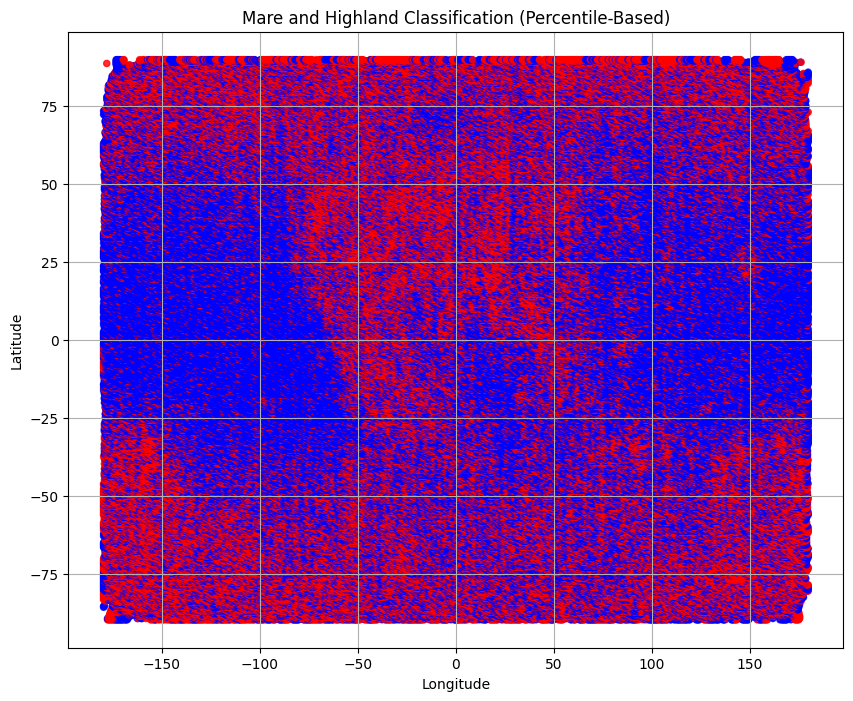

In [64]:
# Calculate dynamic percentile thresholds
al_high = df_kriged["al/si_kriged"].quantile(0.2)  
al_low = df_kriged["al/si_kriged"].quantile(0.5)   
mg_high = df_kriged["mg/si_kriged"].quantile(0.2)  
mg_low = df_kriged["mg/si_kriged"].quantile(0.5)   
# Classification function using percentiles
def classify_region_dynamic(al, mg, al_high, al_low, mg_high, mg_low):
    if al > al_high and mg < mg_low:
        return "Highland"
    elif mg > mg_high and al < al_low:
        return "Mare"
    else:
        return None  # Exclude points that do not strictly meet the criteria

# Apply classification
df_kriged["region_class"] = df_kriged.apply(
    lambda row: classify_region_dynamic(
        row["al/si_kriged"], row["mg/si_kriged"], al_high, al_low, mg_high, mg_low
    ), axis=1
)

# Drop rows without classification
df_classified = df_kriged.dropna(subset=["region_class"])

# Plotting
if not df_classified.empty:
    region_map = {"Highland": "blue", "Mare": "red"}
    df_classified["color"] = df_classified["region_class"].map(region_map)

    plt.figure(figsize=(10, 8))
    plt.scatter(
        df_classified["cent_lon"],
        df_classified["cent_lat"],
        c=df_classified["color"],
        s=20,
        alpha=0.8
    )
    plt.title("Mare and Highland Classification (Percentile-Based)")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.grid(True)
    plt.show()
else:
    print("No classified data points available for plotting.")


C:\Users\robo\AppData\Local\Temp\ipykernel_87936\2742448153.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_classified["color"] = df_classified["region_class"].map(region_map)


C:\Users\robo\AppData\Local\Temp\ipykernel_87936\2742448153.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_classified["color"] = df_classified["region_class"].map(region_map)
C:\Users\robo\AppData\Local\Temp\ipykernel_87936\2742448153.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_classified["color"] = df_classified["region_class"].map(region_map)
C:\Users\robo\AppData\Local\Temp\ipykernel_87936\2742448153.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fro

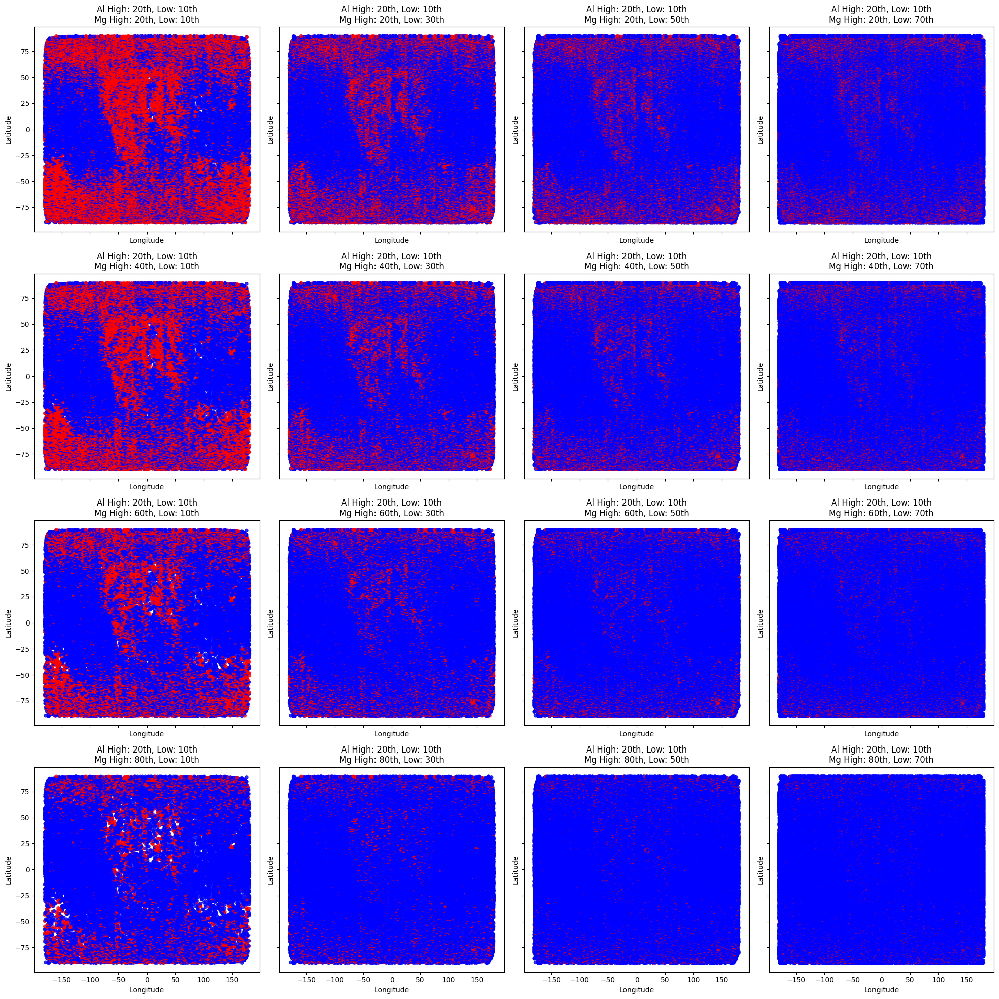

C:\Users\robo\AppData\Local\Temp\ipykernel_87936\2742448153.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_classified["color"] = df_classified["region_class"].map(region_map)
C:\Users\robo\AppData\Local\Temp\ipykernel_87936\2742448153.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_classified["color"] = df_classified["region_class"].map(region_map)
C:\Users\robo\AppData\Local\Temp\ipykernel_87936\2742448153.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fro

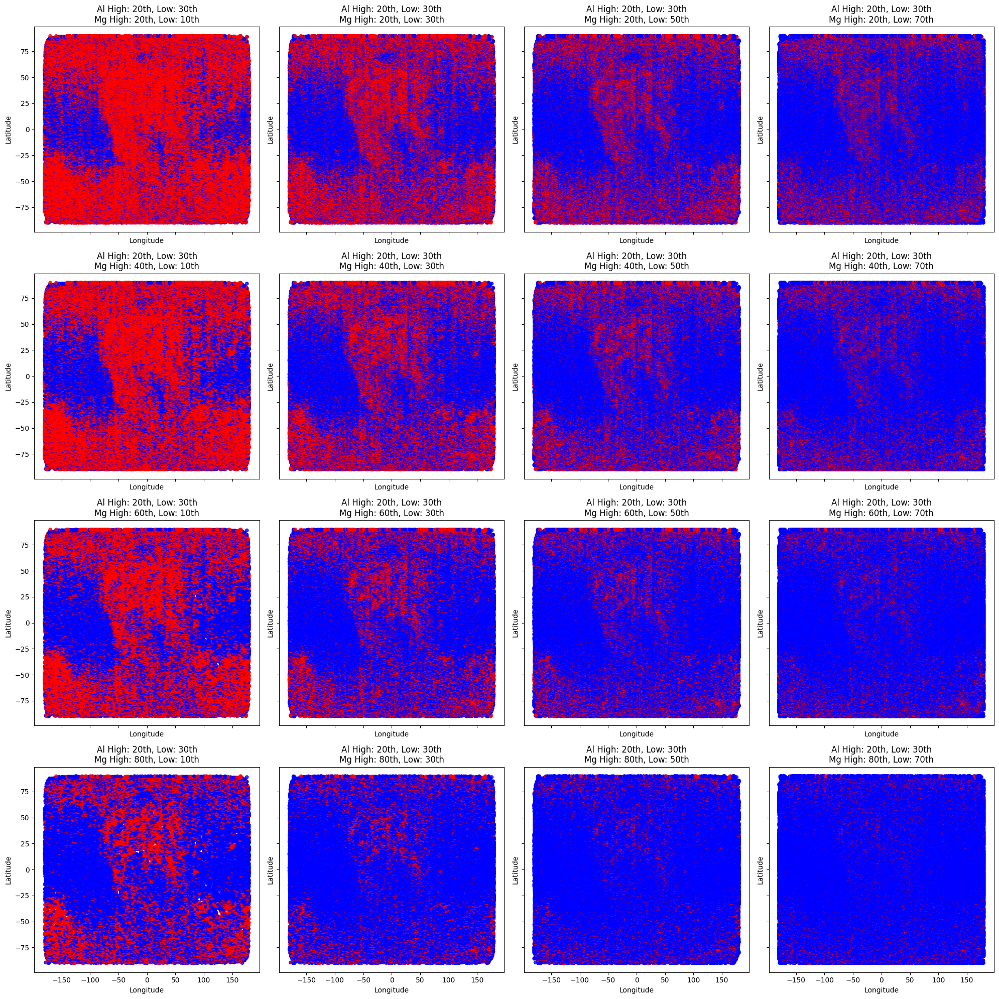

C:\Users\robo\AppData\Local\Temp\ipykernel_87936\2742448153.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_classified["color"] = df_classified["region_class"].map(region_map)
C:\Users\robo\AppData\Local\Temp\ipykernel_87936\2742448153.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_classified["color"] = df_classified["region_class"].map(region_map)
C:\Users\robo\AppData\Local\Temp\ipykernel_87936\2742448153.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fro

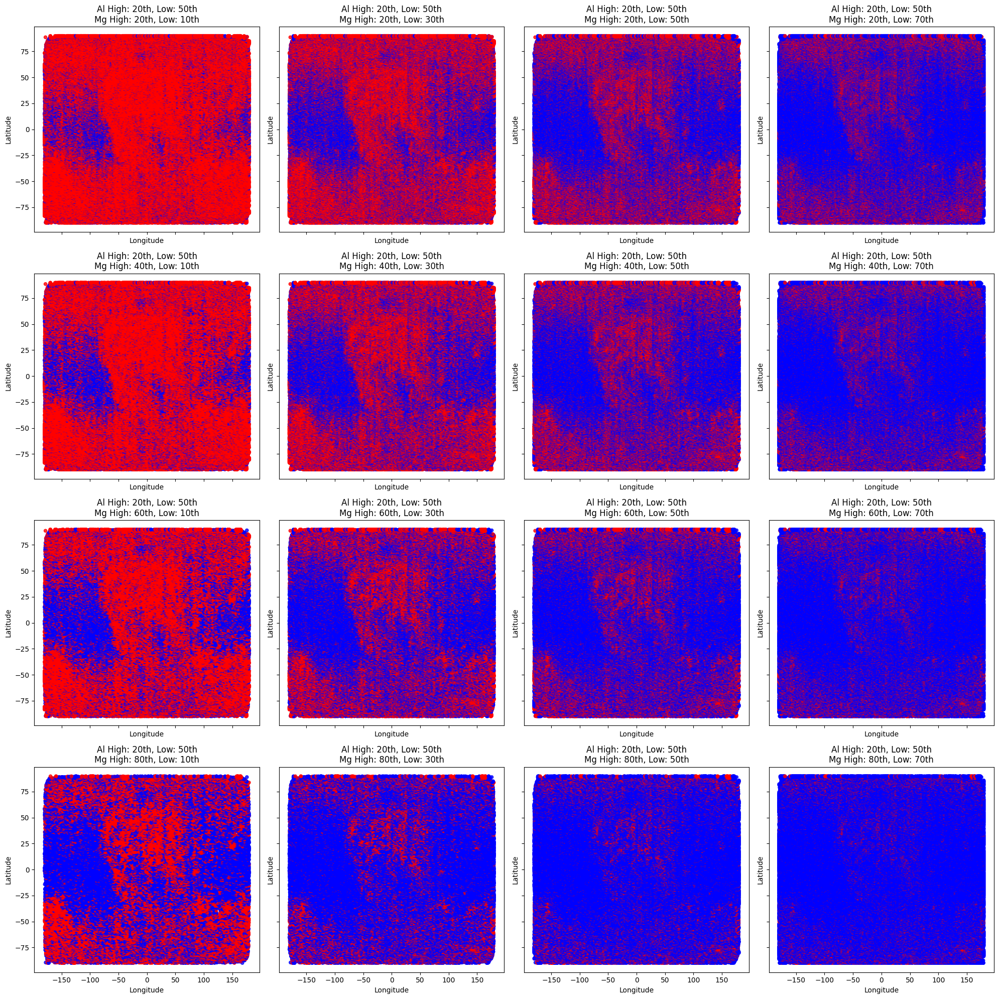

C:\Users\robo\AppData\Local\Temp\ipykernel_87936\2742448153.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_classified["color"] = df_classified["region_class"].map(region_map)
C:\Users\robo\AppData\Local\Temp\ipykernel_87936\2742448153.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_classified["color"] = df_classified["region_class"].map(region_map)
C:\Users\robo\AppData\Local\Temp\ipykernel_87936\2742448153.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fro

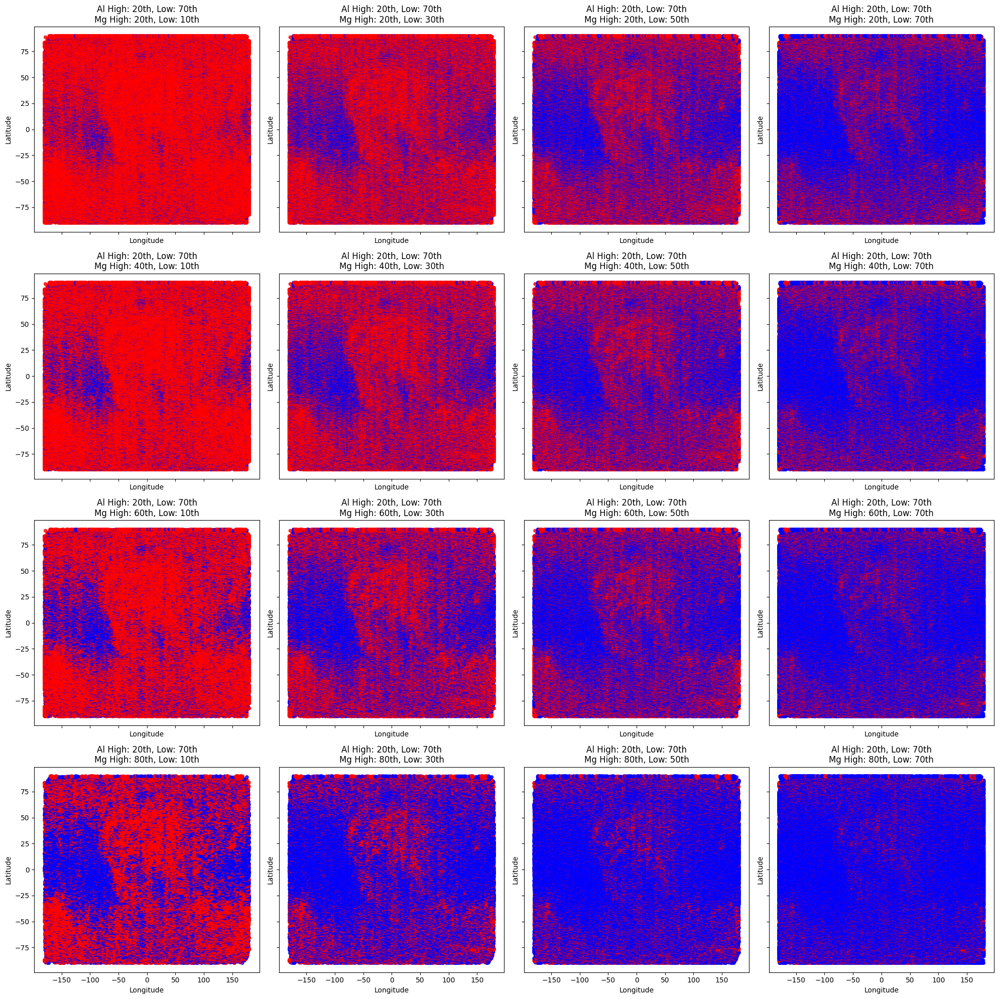

C:\Users\robo\AppData\Local\Temp\ipykernel_87936\2742448153.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_classified["color"] = df_classified["region_class"].map(region_map)
C:\Users\robo\AppData\Local\Temp\ipykernel_87936\2742448153.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_classified["color"] = df_classified["region_class"].map(region_map)
C:\Users\robo\AppData\Local\Temp\ipykernel_87936\2742448153.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fro

KeyboardInterrupt: 

In [ ]:
import matplotlib.pyplot as plt
import itertools

# Define separate percentile ranges for high and low thresholds
al_high_percentiles = [0.2, 0.4, 0.6, 0.8]  # Percentiles for Al/Si high
al_low_percentiles = [0.1, 0.3, 0.5, 0.7]   # Percentiles for Al/Si low
mg_high_percentiles = [0.2, 0.4, 0.6, 0.8]  # Percentiles for Mg/Si high
mg_low_percentiles = [0.1, 0.3, 0.5, 0.7]   # Percentiles for Mg/Si low

# Generate all combinations of percentiles
combinations = list(itertools.product(al_high_percentiles, al_low_percentiles, mg_high_percentiles, mg_low_percentiles))

# Plotting parameters
subplots_per_page = 16  # Number of subplots per page
num_pages = (len(combinations) + subplots_per_page - 1) // subplots_per_page

# Loop through each page
for page in range(num_pages):
    fig, axes = plt.subplots(4, 4, figsize=(20, 20), sharex=True, sharey=True)
    axes = axes.flatten()

    # Loop through each combination in this page
    for idx, combo in enumerate(combinations[page * subplots_per_page:(page + 1) * subplots_per_page]):
        al_high, al_low, mg_high, mg_low = combo

        # Calculate thresholds for the current combination
        al_high_thresh = df_kriged["al/si_kriged"].quantile(al_high)
        al_low_thresh = df_kriged["al/si_kriged"].quantile(al_low)
        mg_high_thresh = df_kriged["mg/si_kriged"].quantile(mg_high)
        mg_low_thresh = df_kriged["mg/si_kriged"].quantile(mg_low)

        # Classification function using high/low thresholds
        def classify_region_dynamic(al, mg, al_h, al_l, mg_h, mg_l):
            if al > al_h and mg < mg_l:
                return "Highland"
            elif mg > mg_h and al < al_l:
                return "Mare"
            else:
                return None

        # Apply classification
        df_kriged["region_class"] = df_kriged.apply(
            lambda row: classify_region_dynamic(
                row["al/si_kriged"], row["mg/si_kriged"], al_high_thresh, al_low_thresh, mg_high_thresh, mg_low_thresh
            ), axis=1
        )

        # Filter classified data
        df_classified = df_kriged.dropna(subset=["region_class"])

        # Plot the current combination
        ax = axes[idx]
        if not df_classified.empty:
            region_map = {"Highland": "blue", "Mare": "red"}
            df_classified["color"] = df_classified["region_class"].map(region_map)

            ax.scatter(
                df_classified["cent_lon"],
                df_classified["cent_lat"],
                c=df_classified["color"],
                s=20,
                alpha=0.8
            )
        ax.set_title(f"Al High: {int(al_high*100)}th, Low: {int(al_low*100)}th\nMg High: {int(mg_high*100)}th, Low: {int(mg_low*100)}th")
        ax.set_xlabel("Longitude")
        ax.set_ylabel("Latitude")

    # Hide unused subplots
    for remaining_idx in range(idx + 1, len(axes)):
        axes[remaining_idx].set_visible(False)

    # Adjust layout and save/show the figure
    plt.tight_layout()
    plt.show()


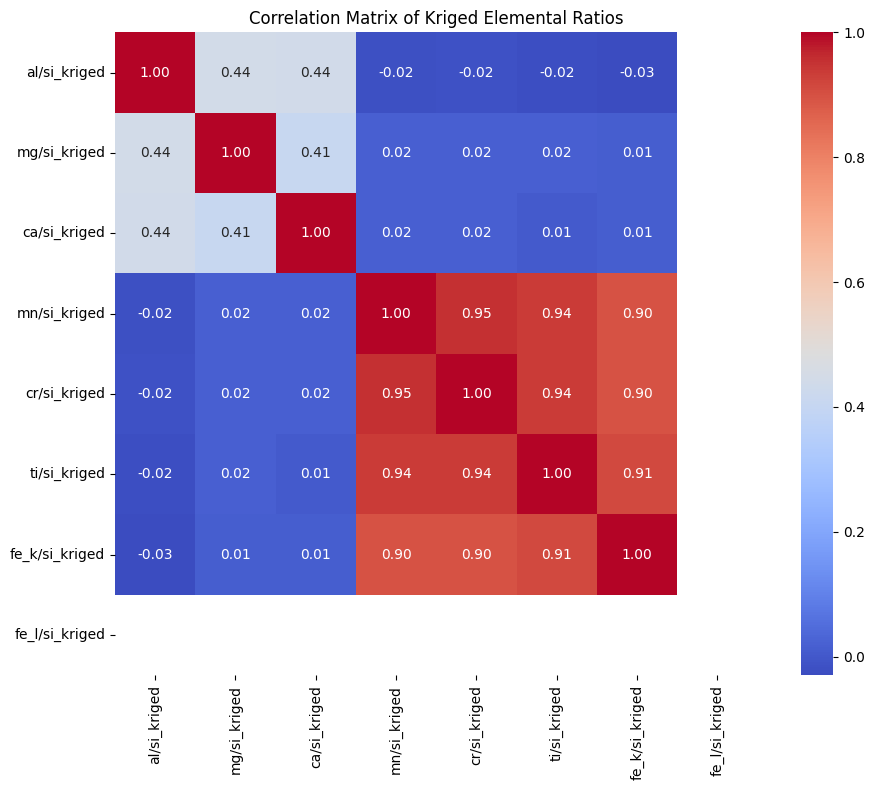

In [ ]:
# ========================
# 3. CORRELATION MATRIX
# ========================
df_kriged["al/si"] = dt["al/si"].clip(0, 0.8)
df_kriged["mg/si"] = dt["mg/si"].clip(0, 0.4)
corr = df_kriged[kriged_cols].corr()
"""dt = pd.read_csv("catalogue_with_updated_solar_flare_data_clipped.csv")
dt["al/si"] = dt["al/si"].clip(0, 0.8)
dt["mg/si"] = dt["mg/si"].clip(0, 0.4)
cols = [
    "al/si","mg/si","ca/si",
    "mn/si","cr/si","ti/si",
    "fe_k/si"
]
corr = dt[cols].corr()"""
plt.figure(figsize=(10,8))
sns.heatmap(corr, annot=True, cmap="coolwarm", fmt=".2f", square=True)
plt.title("Correlation Matrix of Kriged Elemental Ratios")
plt.tight_layout()
plt.show()

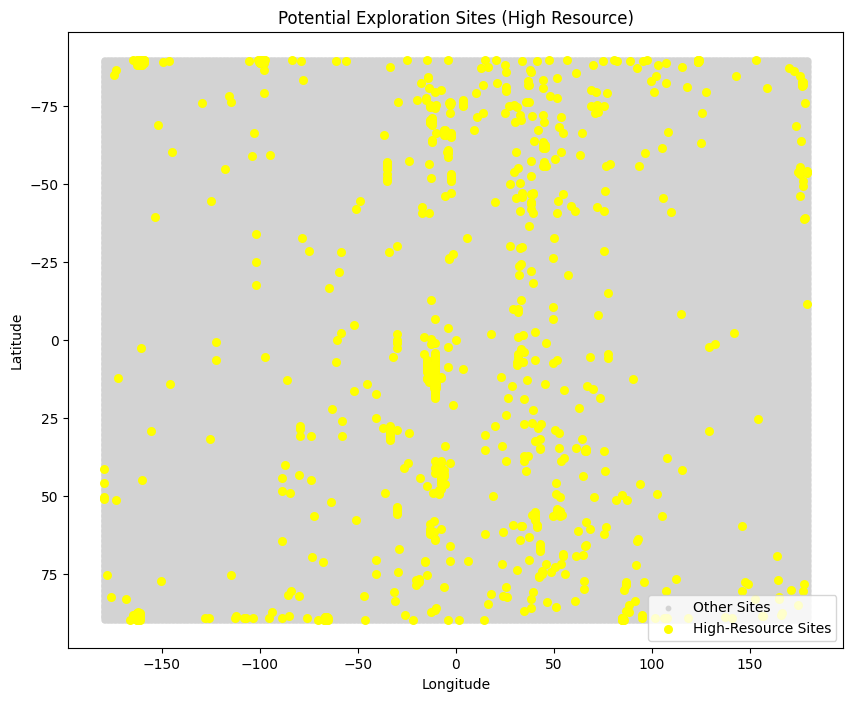

In [ ]:
# ========================
# IDENTIFY POTENTIAL EXPLORATION SITES
# ========================
# Define criteria: e.g., top 10% in Mg/Si or Ti/Si or Fe_k/Si might be resource-rich.
threshold_mg = df_kriged["mg/si_kriged"].quantile(0.999)
threshold_ti = df_kriged["ti/si_kriged"].quantile(0.999)
threshold_fe_k = df_kriged["fe_k/si_kriged"].quantile(0.999)

# Mark sites that exceed any of these thresholds as "High-Resource"
df_kriged["high_resource"] = (
    (df_kriged["mg/si_kriged"] >= threshold_mg) |
    (df_kriged["ti/si_kriged"] >= threshold_ti) |
    (df_kriged["fe_k/si_kriged"] >= threshold_fe_k)
)

# Plot these high-resource sites
plt.figure(figsize=(10,8))
plt.scatter(df_kriged["cent_lon"], df_kriged["cent_lat"], c="lightgray", s=10, label="Other Sites")
plt.scatter(
    df_kriged.loc[df_kriged["high_resource"], "cent_lon"],
    df_kriged.loc[df_kriged["high_resource"], "cent_lat"],
    c="yellow", s=30, label="High-Resource Sites"
)
plt.title("Potential Exploration Sites (High Resource)")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.gca().invert_yaxis()
plt.legend()
plt.show()

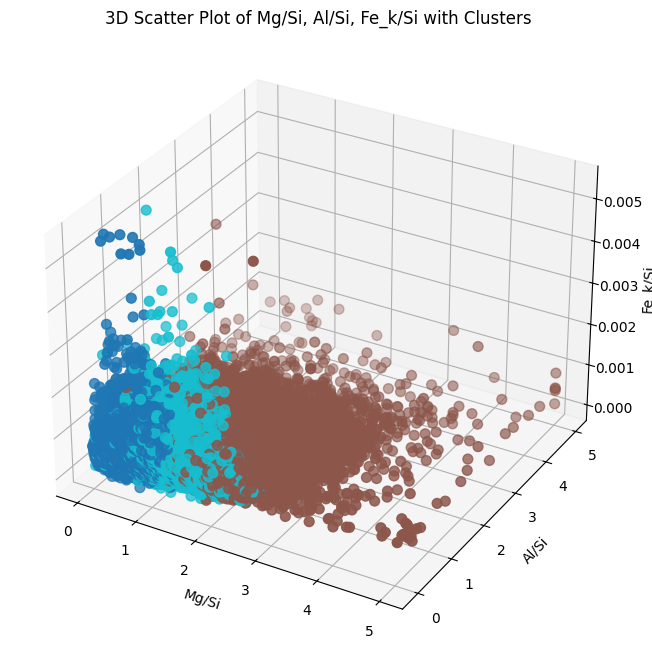

In [ ]:
# ========================
# 7. K-MEANS CLUSTERING (Optional)
# ========================
X = df_kriged[kriged_cols].values
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(X)
df_kriged["cluster"] = clusters

# 3D Scatter Plot Example
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(10,8))
ax = fig.add_subplot(111, projection='3d')

x_col = "mg/si_kriged"
y_col = "al/si_kriged"
z_col = "fe_k/si_kriged"

scatter = ax.scatter(df_kriged[x_col], df_kriged[y_col], df_kriged[z_col], c=clusters, cmap="tab10", s=50)
ax.set_xlabel("Mg/Si")
ax.set_ylabel("Al/Si")
ax.set_zlabel("Fe_k/Si")
ax.set_title("3D Scatter Plot of Mg/Si, Al/Si, Fe_k/Si with Clusters")
plt.show()

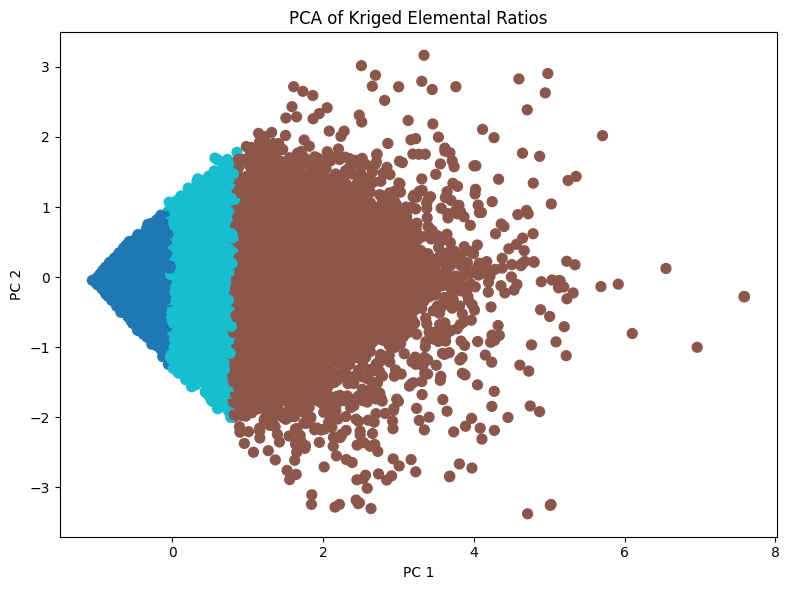

In [ ]:
# ========================
# 8. PCA
# ========================
pca = PCA(n_components=2)
pca_data = pca.fit_transform(X)

plt.figure(figsize=(8,6))
plt.scatter(pca_data[:,0], pca_data[:,1], c=clusters, cmap="tab10", s=50)
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.title("PCA of Kriged Elemental Ratios")
plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV file
file_path = "kriged_results_using_clipped_catalogue.csv"  # Replace with your CSV file path
df_kriged = pd.read_csv(file_path)

# Define thresholds for each feature
al_si_high = df_kriged["al/si_kriged"].quantile(0.75)
fe_si_low = df_kriged["fe_k/si_kriged"].quantile(0.25)
fe_si_high = df_kriged["fe_k/si_kriged"].quantile(0.75)
mg_si_high = df_kriged["mg/si_kriged"].quantile(0.75)
ti_si_high = df_kriged["ti/si_kriged"].quantile(0.90)
cr_si_high = df_kriged["cr/si_kriged"].quantile(0.95)

# Volcanic Activity Indicators: High Ti/Si
df_volcanic = df_kriged[
    df_kriged["ti/si_kriged"] > ti_si_high
]

# Impact Features: High Fe/Si and Cr/Si
df_impacts = df_kriged[
    (df_kriged["fe_k/si_kriged"] > fe_si_high) &
    (df_kriged["cr/si_kriged"] > cr_si_high)
]

# Potential Ore Deposits: High Mg/Si, Fe/Si, Ti/Si
df_ore_deposits = df_kriged[
    (df_kriged["mg/si_kriged"] > mg_si_high) &
    (df_kriged["fe_k/si_kriged"] > fe_si_high) &
    (df_kriged["ti/si_kriged"] > ti_si_high)
]

# Plot each feature
def plot_regions(df, title, color):
    if not df.empty:
        plt.scatter(df["cent_lon"], df["cent_lat"], c=color, s=20, alpha=0.8, label=title)

plt.figure(figsize=(12, 10))
plot_regions(df_volcanic, "Volcanic Activity (Ilmenite)", "orange")
plot_regions(df_impacts, "Impact Features", "purple")
plot_regions(df_ore_deposits, "Ore Deposits (ISRU)", "green")

plt.title("Lunar Geological Features Based on Elemental Ratios")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.legend()
plt.grid(True)
plt.show()
